In [ ]:
import numpy as np
import pandas as pd
import time
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error, r2_score

In [ ]:
class DataLoader:
    def __init__(self, file_path=None, dataframe=None):
        if file_path:
            self.df = pd.read_csv(file_path)
        elif dataframe is not None:
            self.df = dataframe.copy()
        else:
            raise ValueError("Must provide either file_path or dataframe")

        self.means = {}
        self.scalers = {}
        self._is_fitted = False
        self.target_col = self.df.columns[-1]  # Store target column name

    def fit(self):
        """Calculate and store preprocessing parameters using standard scaling"""
        # Handle NA in target first
        self.df.dropna(subset=[self.target_col], inplace=True)

        # Calculate mean and standard deviation for each feature
        for col in self.df.columns[:-1]:
            self.means[col] = self.df[col].mean()  # Mean for NA filling
            std_dev = self.df[col].std()          # Standard deviation for scaling
            if std_dev == 0:                      # Handle zero standard deviation
                std_dev = 1.0  # Avoid division by zero; treat as constant column
            self.scalers[col] = {
                'mean': self.means[col],
                'std': std_dev
            }
        self._is_fitted = True

    def transform(self, external_loader=None):
        """Apply complete preprocessing pipeline using standard scaling"""
        processor = external_loader if external_loader else self
        transformed_df = self.df.copy()

        # Feature NA filling and standard scaling
        for col in transformed_df.columns[:-1]:
            if col in processor.scalers:
                mean_val = processor.scalers[col]['mean']
                std_val = processor.scalers[col]['std']
                transformed_df[col] = transformed_df[col].fillna(mean_val)  # Fill missing values
                transformed_df[col] = (transformed_df[col] - mean_val) / std_val  # Standard scaling

        return DataLoader(dataframe=transformed_df)  # Return a new DataLoader object

    def inverse_transform(self, scaled_data, external_loader=None):
        """Reverse standard scaling transformation"""
        processor = external_loader if external_loader else self
        original_df = scaled_data.df.copy()

        for col in original_df.columns[:-1]:
            if col in processor.scalers:
                mean_val = processor.scalers[col]['mean']
                std_val = processor.scalers[col]['std']
                original_df[col] = scaled_data.df[col] * std_val + mean_val

        return DataLoader(dataframe=original_df)  # Return a new DataLoader object

    def get_X_y(self):
        """Return features and target with guaranteed non-NA target"""
        clean_df = self.df.dropna(subset=[self.target_col])
        return clean_df.iloc[:, :-1], clean_df.iloc[:, -1]

    def get_X_y_numpy(self):
        """Return features and target with guaranteed non-NA target"""
        clean_df = self.df.dropna(subset=[self.target_col])
        return clean_df.iloc[:, :-1].to_numpy(), clean_df.iloc[:, -1].to_numpy()

    def train_test_split(self, test_size=0.2, random_state=None):
        """Create train/test DataLoader instances after cleaning"""
        clean_df = self.df.dropna(subset=[self.target_col])
        if random_state:
            np.random.seed(random_state)

        indices = np.random.permutation(len(clean_df))
        test_size = int(len(clean_df) * test_size)

        return (
            DataLoader(dataframe=clean_df.iloc[indices[test_size:]]),
            DataLoader(dataframe=clean_df.iloc[indices[:test_size]])
        )

    @property
    def is_fitted(self):
        return self._is_fitted


In [ ]:
path = "Biofluid.csv"
data = DataLoader(path)
data.fit()

In [ ]:
class LWR:
    def __init__(self,data,tau):
        self.data=data
        self.tau=tau
        self.X,self.Y= self.data.get_X_y_numpy()

    def local_weighted_regression(self,x0):
        x0 = np.r_[1, x0]
        X = np.c_[np.ones(len(self.X)), self.X]
        # fit model: normal equations with kernel
        xw = X.T * self.weights_calculate(X,x0)
        theta = np.linalg.pinv(xw @ X) @ xw @ self.Y
        # "@" is used to predict value
        return x0 @ theta

    # function to perform weight calculation
    def weights_calculate(self,X,x0):
        distances = np.sum((X - x0) ** 2, axis=1)
        return np.exp(distances / (-2 * (self.tau **2)))

In [ ]:
dataTrain,dataTest=data.train_test_split()
dataTrain.fit()
transformedTrain =dataTrain.transform()
transformedTest,transformedVal =dataTest.transform(dataTrain).get_X_y_numpy()
lwr = LWR(transformedTrain,tau=0.011)
predictions = [lwr.local_weighted_regression(x0) for x0 in transformedTest]
mae=mean_absolute_error(transformedVal ,predictions)
r2=r2_score(transformedVal ,predictions)

In [ ]:
mae

52.6407025468693

In [ ]:
r2

-0.24307911490282197

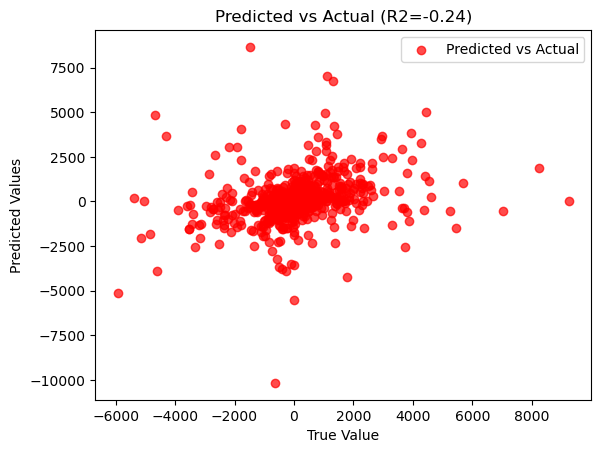

In [ ]:
plt.scatter(transformedVal ,predictions,label='Predicted vs Actual', color='red', alpha=0.7)
plt.xlabel('True Value')
plt.ylabel('Predicted Values')
plt.title(f'Predicted vs Actual (R2={r2:.2f})')
plt.legend()
plt.show()

# EDA

In [ ]:
df=data.df

## E vs d <sup>2</sup>

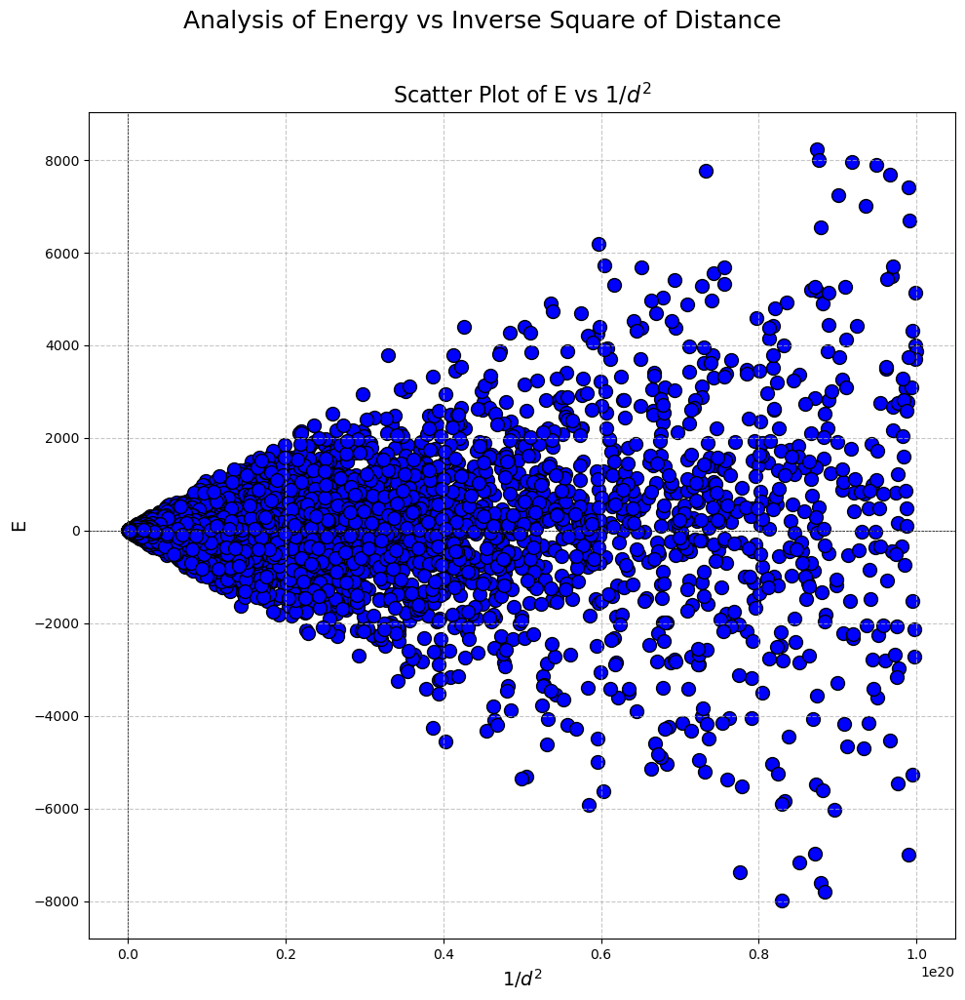

In [ ]:
df['_d2'] = 1 / (df['d'] ** 2)
df['Ed2'] = df['E'] * (df['d'] ** 2)
plt.figure(figsize=(10, 10))
plt.scatter(x=df['_d2'], y=df['E'], color='blue', edgecolor='black', s=100)
plt.title('Scatter Plot of E vs $1/d^2$', fontsize=16)
plt.suptitle('Analysis of Energy vs Inverse Square of Distance', fontsize=18, y=1.02)  # Adding a figure title
plt.ylabel('E', fontsize=14)
plt.xlabel('$1/d^2$', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.7)
plt.axhline(0, color='black', linewidth=0.5, linestyle='--')
plt.axvline(0, color='black', linewidth=0.5, linestyle='--')
plt.tight_layout()
plt.show()


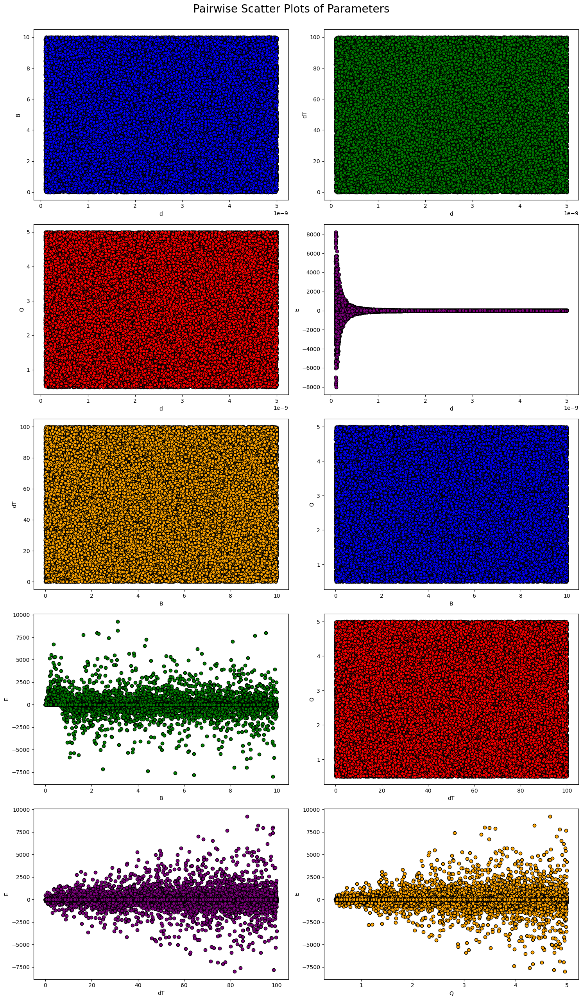

In [ ]:
# Parameters list
parameters = ['d', 'B', 'dT', 'Q', 'E']

# Create subplots
fig, axes = plt.subplots(5, 2, figsize=(15, 25))  # Arrange in a grid of 5 rows and 2 columns
axes = axes.flatten()  # Flatten the axes array for easy iteration

colors = ['blue', 'green', 'red', 'purple', 'orange']  # Different colors for each plot
plot_index = 0

# Iterate through all combinations of parameters
for i in range(len(parameters)):
    for j in range(i + 1, len(parameters)):
        x_param = parameters[i]
        y_param = parameters[j]

        if y_param == 'E':
            # Always keep E on the y-axis if it is involved
            axes[plot_index].scatter(df[x_param], df[y_param], color=colors[plot_index % len(colors)], edgecolor='black')
            axes[plot_index].set_xlabel(x_param)
            axes[plot_index].set_ylabel(y_param)
        elif x_param == 'E':
            # If E is on the x-axis, flip it to y-axis
            axes[plot_index].scatter(df[y_param], df[x_param], color=colors[plot_index % len(colors)], edgecolor='black')
            axes[plot_index].set_xlabel(y_param)
            axes[plot_index].set_ylabel(x_param)
        else:
            # If E is not involved at all
            axes[plot_index].scatter(df[x_param], df[y_param], color=colors[plot_index % len(colors)], edgecolor='black')
            axes[plot_index].set_xlabel(x_param)
            axes[plot_index].set_ylabel(y_param)

        plot_index += 1

# Adjust layout and add a title
plt.tight_layout()
plt.suptitle('Pairwise Scatter Plots of Parameters', fontsize=20, y=1.02)
plt.show()


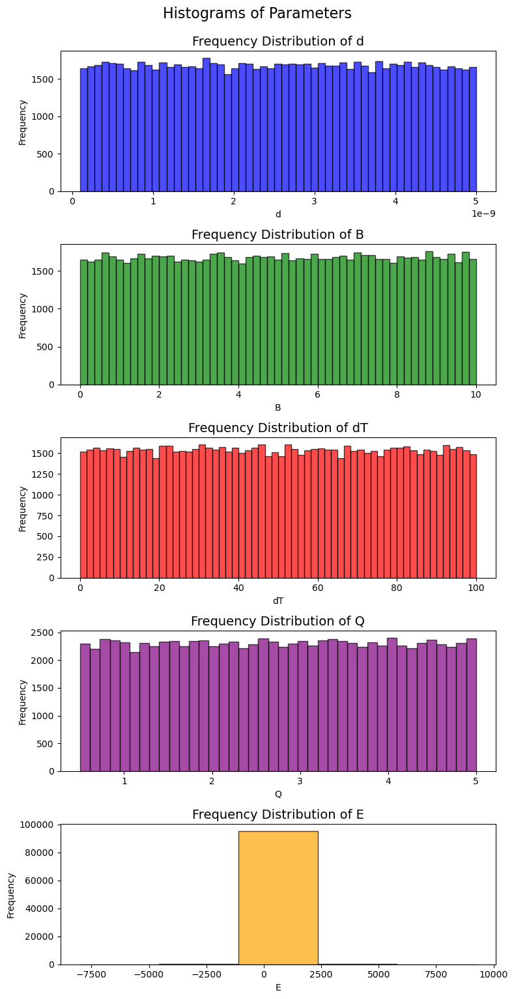

In [ ]:
# Parameters list
parameters = ['d', 'B', 'dT', 'Q', 'E']

# Create subplots
fig, axes = plt.subplots(len(parameters), 1, figsize=(8, len(parameters) * 3))  # One subplot per parameter

# Colors for each histogram
colors = ['blue', 'green', 'red', 'purple', 'orange']
bins = [55,55,60,40,5]
# Plot histograms
for i, param in enumerate(parameters):
    axes[i].hist(df[param], bins=bins[i], color=colors[i], edgecolor='black', alpha=0.7)
    axes[i].set_title(f'Frequency Distribution of {param}', fontsize=14)
    axes[i].set_xlabel(param)
    axes[i].set_ylabel('Frequency')

# Adjust layout
plt.tight_layout()
plt.suptitle('Histograms of Parameters', fontsize=16, y=1.02)
plt.show()


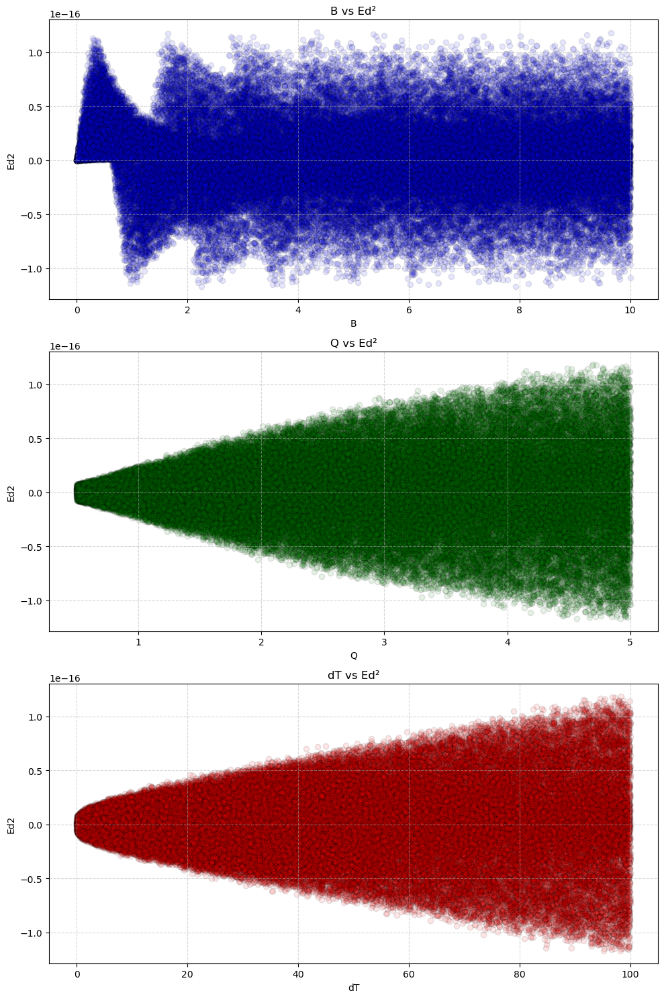

In [ ]:
# Plot each parameter vs Ed2
fig, axes = plt.subplots(3, 1, figsize=(10, 15))

# B vs Ed2
axes[0].scatter(df['B'], df['Ed2'], color='blue', alpha=0.1, edgecolor='black')
axes[0].set_xlabel('B')
axes[0].set_ylabel('Ed2')
axes[0].set_title('B vs Ed²')
axes[0].grid(True, linestyle='--', alpha=0.5)

# Q vs Ed2
axes[1].scatter(df['Q'], df['Ed2'], color='green', alpha=0.1, edgecolor='black')
axes[1].set_xlabel('Q')
axes[1].set_ylabel('Ed2')
axes[1].set_title('Q vs Ed²')
axes[1].grid(True, linestyle='--', alpha=0.5)

# dT vs Ed2
axes[2].scatter(df['dT'], df['Ed2'], color='red', alpha=0.1, edgecolor='black')
axes[2].set_xlabel('dT')
axes[2].set_ylabel('Ed2')
axes[2].set_title('dT vs Ed²')
axes[2].grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()


C:\Users\arnab\AppData\Local\Temp\ipykernel_8656\42924755.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', 9)


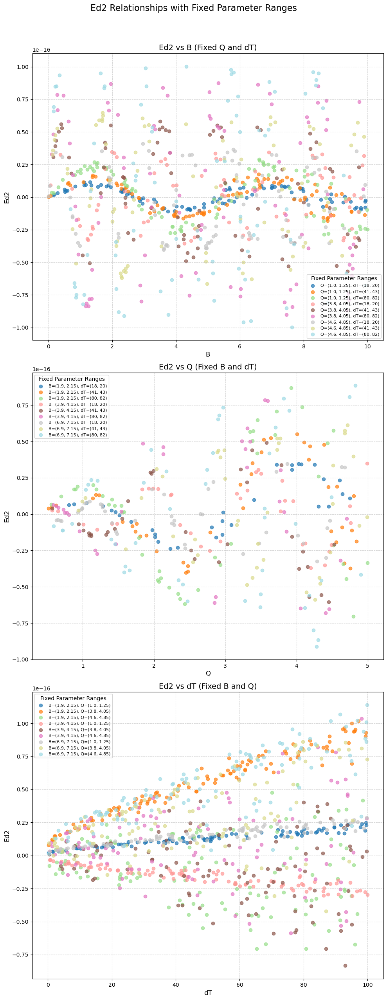

In [ ]:
fixed_ranges = {
    'B': [(1.9, 2.15), (3.9, 4.15), (6.9, 7.15)],
    'Q': [(1.0, 1.25), (3.8, 4.05), (4.6, 4.85)],
    'dT': [(18, 20), (41, 43), (80, 82)]
}

# 3. Create Subplots (Vertical Arrangement)
fig, axes = plt.subplots(3, 1, figsize=(10, 25))
plt.subplots_adjust(hspace=0.3)

# Define a colormap with 9 distinct colors
cmap = plt.cm.get_cmap('tab20', 9)

# 4. Plot Each Subplot with 9 Classes
for ax_idx, (x_param, fixed_params) in enumerate(zip(
    ['B', 'Q', 'dT'],
    [('Q', 'dT'), ('B', 'dT'), ('B', 'Q')]
)):
    ax = axes[ax_idx]
    class_idx = 0

    # Iterate over all combinations of fixed parameters
    for range1 in fixed_ranges[fixed_params[0]]:
        for range2 in fixed_ranges[fixed_params[1]]:
            # Filter data based on fixed parameter ranges
            mask = (
                (df[fixed_params[0]].between(range1[0], range1[1])) &
                (df[fixed_params[1]].between(range2[0], range2[1]))
            )
            filtered_df = df[mask]

            # Scatter plot with unique color
            ax.scatter(
                filtered_df[x_param], filtered_df['Ed2'],
                color=cmap(class_idx),
                label=f'{fixed_params[0]}={range1}, {fixed_params[1]}={range2}',
                alpha=0.7
            )
            class_idx += 1

    ax.set_xlabel(x_param, fontsize=12)
    ax.set_ylabel('Ed2', fontsize=12)
    ax.set_title(f'Ed2 vs {x_param} (Fixed {fixed_params[0]} and {fixed_params[1]})', fontsize=14)
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.legend(title='Fixed Parameter Ranges', fontsize=8, title_fontsize=10)

plt.suptitle('Ed2 Relationships with Fixed Parameter Ranges', fontsize=16, y=1.02)
plt.tight_layout()
plt.show()


### Conclusion
We know that Ed<sup>2</sup> = `f(B,Q,dT)`
From the above two plots, we can conclude that:
- Ed<sup>2</sup> ∝ dTᵞ , where 0<ɣ<1
- Ed<sup>2</sup> ∝ sin(λB) where λ is g(Q), g is increasing
- Ed<sup>2</sup> ∝ Qsin(μQ) where μ is h(B), h is increasing
- Combining the above two, we get Ed<sup>2</sup> ∝ Qsin(kBQ) , where k is a constant

We need to find ɣ and k such that Ed<sup>2</sup> = ∝Qsin(kBQ)dTᵞ, where ∝ is a constant

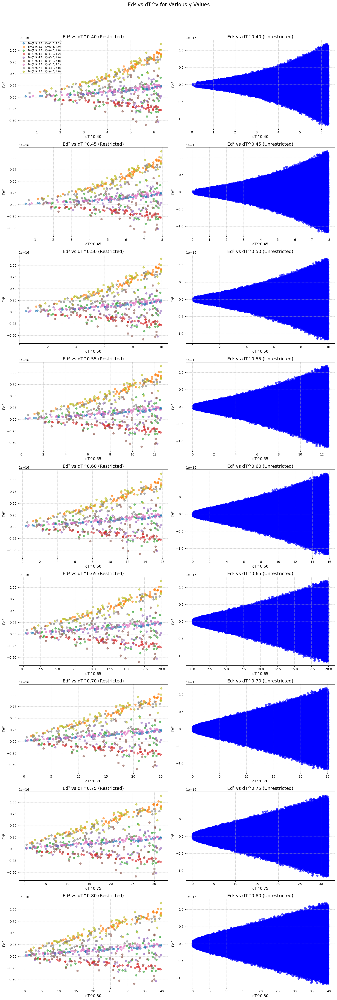

In [ ]:
# Define fixed ranges for B and Q
fixed_ranges = {
    'B': [(1.9, 2.1), (3.9, 4.1), (6.9, 7.1)],
    'Q': [(1.0, 1.2), (3.8, 4.0), (4.6, 4.8)]
}

# Gamma values
gamma_values = np.arange(0.4, 0.85, 0.05)

# Plotting
fig, axes = plt.subplots(len(gamma_values), 2, figsize=(15, len(gamma_values) * 5))
plt.subplots_adjust(hspace=0.4)

for i, gamma in enumerate(gamma_values):
    # Calculate dT^gamma
    df[f'dT^{gamma:.2f}'] = df['dT'] ** gamma

    # Scatter plot with restrictions
    ax_restricted = axes[i][0]
    class_idx = 0

    for b_range in fixed_ranges['B']:
        for q_range in fixed_ranges['Q']:
            mask = (
                (df['B'].between(b_range[0], b_range[1])) &
                (df['Q'].between(q_range[0], q_range[1]))
            )
            filtered_df = df[mask]
            ax_restricted.scatter(
                filtered_df[f'dT^{gamma:.2f}'], filtered_df['Ed2'],
                label=f'B={b_range}, Q={q_range}',
                alpha=0.6
            )
            class_idx += 1

    ax_restricted.set_xlabel(f'dT^{gamma:.2f}', fontsize=12)
    ax_restricted.set_ylabel('Ed²', fontsize=12)
    ax_restricted.set_title(f'Ed² vs dT^{gamma:.2f} (Restricted)', fontsize=14)
    ax_restricted.grid(True, linestyle='--', alpha=0.5)
    if i == 0:
        ax_restricted.legend(fontsize=8)

    # Scatter plot without restrictions
    ax_unrestricted = axes[i][1]
    ax_unrestricted.scatter(
        df[f'dT^{gamma:.2f}'], df['Ed2'],
        color='blue', alpha=0.6
    )
    ax_unrestricted.set_xlabel(f'dT^{gamma:.2f}', fontsize=12)
    ax_unrestricted.set_ylabel('Ed²', fontsize=12)
    ax_unrestricted.set_title(f'Ed² vs dT^{gamma:.2f} (Unrestricted)', fontsize=14)
    ax_unrestricted.grid(True, linestyle='--', alpha=0.5)

plt.suptitle('Ed² vs dT^γ for Various γ Values', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


#### from the graph dT^0.7 is best visually

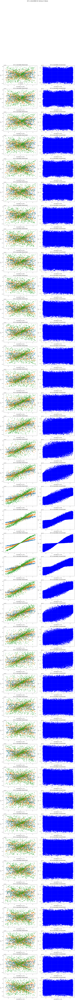

In [ ]:
# Define fixed ranges for dT
fixed_ranges_dT = [(18, 19), (41, 42), (80, 81)]

# k values
k_values = np.arange(0.8, 1.2, 0.01)

# Plotting
fig, axes = plt.subplots(len(k_values), 2, figsize=(15, len(k_values) * 5))
plt.subplots_adjust(hspace=0.4)

for i, k in enumerate(k_values):
    # Calculate Qsin(kBQ)
    df[f'Qsin(kBQ)_{k:.2f}'] = df['Q'] * np.sin(k * df['B'] * df['Q'])

    # Scatter plot with restrictions
    ax_restricted = axes[i][0]
    class_idx = 0

    for dT_range in fixed_ranges_dT:
        mask = df['dT'].between(dT_range[0], dT_range[1])
        filtered_df = df[mask]
        ax_restricted.scatter(
            filtered_df[f'Qsin(kBQ)_{k:.2f}'], filtered_df['Ed2'],
            label=f'dT={dT_range}',
            alpha=0.6
        )
        class_idx += 1

    ax_restricted.set_xlabel(f'Qsin(kBQ) (k={k:.2f})', fontsize=12)
    ax_restricted.set_ylabel('Ed²', fontsize=12)
    ax_restricted.set_title(f'Ed² vs Qsin(kBQ) (Restricted)', fontsize=14)
    ax_restricted.grid(True, linestyle='--', alpha=0.5)
    if i == 0:
        ax_restricted.legend(fontsize=8)

    # Scatter plot without restrictions
    ax_unrestricted = axes[i][1]
    ax_unrestricted.scatter(
        df[f'Qsin(kBQ)_{k:.2f}'], df['Ed2'],
        color='blue', alpha=0.6
    )
    ax_unrestricted.set_xlabel(f'Qsin(kBQ) (k={k:.2f})', fontsize=12)
    ax_unrestricted.set_ylabel('Ed²', fontsize=12)
    ax_unrestricted.set_title(f'Ed² vs Qsin(kBQ) (Unrestricted)', fontsize=14)
    ax_unrestricted.grid(True, linestyle='--', alpha=0.5)

plt.suptitle('Ed² vs Qsin(kBQ) for Various k Values', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.92])
plt.show()


#### from the set of graphs drawn above, k=1 is perfect
Hence ,
\begin{align*}
E \sim \frac{Q \sin(QB) \cdot dT^{0.7}}{d^2}
\end{align*}


In [ ]:
df.head()

,d,B,Q,dT,E,Qsin(kBQ)_1.10,_d2,Ed2,Qsin(kBQ)_1.11,Qsin(kBQ)_1.12,...,Qsin(kBQ)_0.99,Qsin(kBQ)_1.01,Qsin(kBQ)_1.02,Qsin(kBQ)_1.03,Qsin(kBQ)_1.04,Qsin(kBQ)_1.05,Qsin(kBQ)_1.06,Qsin(kBQ)_1.07,Qsin(kBQ)_1.08,Qsin(kBQ)_1.09
0,1.935247e-09,5.807790,1.771646,15.705398,-3.221133,-1.680193,2.670099e+17,-1.206372e-17,-1.613598,-1.529935,...,-1.222676,-1.458860,-1.554392,-1.633482,-1.695293,-1.739172,-1.764655,-1.771472,-1.759550,-1.729016
1,4.758500e-09,5.269716,2.564045,9.550877,0.652858,1.917825,4.416313e+16,1.478286e-17,1.671094,1.393901,...,1.857635,2.262026,2.404040,2.502231,2.554808,2.560813,2.520137,2.433521,2.302545,2.129595
3,3.033427e-09,4.932127,2.510767,47.348940,-0.819294,2.184599,1.086758e+17,-7.538882e-18,2.320727,2.421313,...,-0.758242,-0.148344,0.162375,0.470607,0.771631,1.060838,1.333798,1.586330,1.814567,2.015013
4,8.644913e-10,3.650966,1.413866,88.453402,-40.038999,-0.804165,1.338070e+18,-2.992296e-17,-0.743092,-0.680039,...,-1.303373,-1.239964,-1.203261,-1.163352,-1.120343,-1.074351,-1.025496,-0.973909,-0.919727,-0.863096
5,8.643731e-10,6.579313,1.749179,30.922074,-26.695892,0.162204,1.338436e+18,-1.994559e-17,0.361124,0.555266,...,-1.612637,-1.415540,-1.288182,-1.143782,-0.984249,-0.811696,-0.628404,-0.436798,-0.239414,-0.038862


In [ ]:
#feature engineering
df_new = pd.DataFrame({
    '1/d^2': 1 / (df['d'] ** 2),
    'dT^0.7': df['dT'] ** 0.7,
    'Qsin(BQ)': df['Q'] * np.sin(df['B'] * df['Q']),
    'E': df['E']
})


In [ ]:
gooddata=DataLoader(dataframe=df_new)

In [ ]:
gooddata.df.head()

,1/d^2,dT^0.7,Qsin(BQ),E
0,2.670099e+17,6.874391,-1.347897,-3.221133
1,4.416313e+16,4.853223,2.078778,0.652858
3,1.086758e+17,14.883915,-0.456791,-0.819294
4,1.338070e+18,23.051552,-1.273365,-40.038999
5,1.338436e+18,11.045568,-1.524171,-26.695892


In [ ]:
gooddatatrain,gooddatatest=gooddata.train_test_split()
gooddatatrain.fit()
gooddatatrainscaled=gooddatatrain.transform()
gooddatatestscaled=gooddatatest.transform(gooddatatrain)

In [ ]:
gooddatatestscaled.df.head()

,1/d^2,dT^0.7,Qsin(BQ),E
96584,-0.243379,0.000000,0.000000,0.965768
84784,-0.217076,-1.730680,-1.661427,-4.223096
44871,0.160576,-1.340400,-0.683162,-29.361353
21806,9.416697,-0.239537,0.000000,917.880528
36015,-0.192486,1.511899,-0.509374,-12.659138


In [ ]:
# Put Linear regression model